In [1]:
import pandas as pd  # for requirements: install fastparquet as well
import matplotlib.pyplot as plt
import numpy as np
import networkx as nx
import folium
from scipy.spatial import Voronoi
from math import floor, dist  # not needed in requirements
from tqdm import tqdm

# FUNCTIONS

In [22]:
def assign_georank(enb_df, src_id, precision=1000):
    cells = np.array(enb_df[['latitude','longitude']])
    centroid = np.array(enb_df[['latitude','longitude']].loc[enb_df['eci_4g']==src_id]) 
    distances = np.linalg.norm(cells-centroid, axis=1) * precision   # normalized distances to centroid, between 0 and 100
    enb_df['Georank'] = [floor(d) for d in distances] 
    return enb_df

In [23]:
def compute_distance(data):
    dist_ser = pd.Series()
    for idx,row in data.iterrows():
        dist_ser[idx] = max(0.1, dist((row.srcLAT,row.srcLON), (row.dstLAT,row.dstLON))*10000)
    data['Distance'] = dist_ser
    return data

def join_ranks(data, enb_df):
    data = data.join(enb_df[['eci_4g','Georank']].set_index('eci_4g'), on='prev_eci_4g')
    data.rename(columns={'Georank':'srcRank'}, inplace=True)
    data = data.join(enb_df[['eci_4g','Georank']].set_index('eci_4g'), on='eci_4g')
    data.rename(columns={'Georank':'dstRank'}, inplace=True)
    return data


def compute_weight(data, method='inverse', absolute=False, enb_df=None):
    if method == 'inverse':
        data['Weight'] = 1/(data['nb_ho'])  
        
    elif method == 'prop':
        ho_max, ho_min = data['nb_ho'].max(), data['nb_ho'].min()
        data['Weight'] = (ho_max - data.nb_ho)/(ho_max-ho_min)
        
    elif method == 'distance':
        if 'Distance' not in data.columns:
            data = compute_distance(data)
        data['Weight'] = data.Distance / data.nb_ho
        
    elif method == 'rank':
        if 'srcRank' not in data.columns:
            data = join_ranks(data, enb_df)
        ser = pd.Series()
        if absolute:
            for idx,row in data.iterrows():
                ser[idx] = max(1, abs(row.srcRank - row.dstRank)) / row.nb_ho
        else:
            for idx,row in data.iterrows():   
                ser[idx] = max(1, row.srcRank - row.dstRank +1) / row.nb_ho
        data['Weight'] = ser
        
    elif method == 'rank-dist':
        if 'srcRank' not in data.columns:
            data = join_ranks(data, enb_df)
        if 'Distance' not in data.columns:
            data = compute_distance(data)
        ser = pd.Series()
        if absolute:
            for idx,row in data.iterrows():
                ser[idx] = max(1, abs(row.srcRank - row.dstRank)) / row.nb_ho
        else:
            for idx,row in data.iterrows():
                ser[idx] = max(1, row.srcRank - row.dstRank +1) / row.nb_ho
        data['Weight'] = ser * data.Distance
        
    elif method == 'log':
        ho_max = data['nb_ho'].max()
        data['Weight'] = np.log(ho_max) - np.log(data.nb_ho)
        
    else:
        raise ValueError('Invalid method. Choose between inverse, prop, distance, rank, rank-dist, or log.')
    return data

In [24]:
def compute_path_ho(data, path):
    path_ho = 0
    for i in range(len(path)-1):
        arc_ho = data.loc[(data['prev_eci_4g']==path[i]) & (data['eci_4g']==path[i+1])]['nb_ho'].iloc[0]
        arc_weight = data.loc[(data['prev_eci_4g']==path[i]) & (data['eci_4g']==path[i+1])]['Weight'].iloc[0]
        #print('Number of handovers between', path[i], 'and', path[i+1],': ', arc_ho, '\tWeight: ', arc_weight)
        path_ho += arc_ho
    return int(path_ho)

def update_graph(graph, path, method='half'):
    if method == 'half':
        for i in range(len(path)-1):
            src, dst = path[i], path[i+1]
            weight = graph[src][dst]['Weight']
            graph[src][dst]['Weight'] = weight*2
            #print('Previous weight:', weight, '\tNew weight:', graph[src][dst]['Weight']) 
    else:
        raise ValueError('Invalid method. Choose between half or min.')
    return graph

In [31]:
def create_map():
    map = folium.Map([48.854816, 2.347061], tiles="OpenStreetMap", zoom_start=13)
    print('Creating base station map...')
    return map

def add_stations(map, df, type='ho', name='4G stations'):
    print('Adding '+name+' layer')
    fg = folium.FeatureGroup(name=name) # Name as it will appear in Layer control
    if type=='ho':
        enb_ids = df.srcLocInfo.unique()
        for id in enb_ids:
            enb_data = df.loc[df['srcLocInfo']==id]
            fg.add_child(folium.Marker(
                location=[enb_data['srcLAT'].iloc[-1], enb_data['srcLON'].iloc[-1]],
                popup=enb_data['srcLocInfo'].iloc[-1],
            ))
    if type=='enb':
        enb_ids = df.eci_4g.tolist()
        for id in enb_ids:
            enb_data = df.loc[df['eci_4g']==id]
            fg.add_child(folium.Marker(
                location=[enb_data['latitude'].iloc[-1], enb_data['longitude'].iloc[-1]],
                popup=enb_data['eci_4g'].iloc[-1],
            ))
    map.add_child(fg)
    
def add_stations_by_centrality(map, df, name='4G stations'):
    print('Adding '+name+' layer...')
    fg = folium.FeatureGroup(name=name) # Name as it will appear in Layer control
    enb_color = {0:'blue', 0.007:'green', 0.026:'yellow', 0.05:'orange', 0.5:'red'}
    for idx,row in df.iterrows():
        ec = [v for k,v in enb_color.items() if row['BC'] <= k]
        fg.add_child(folium.CircleMarker(
            location=[row['LAT'], row['LON']],
            popup=row['LocInfo'],
            tooltip='Centrality: '+str(row['BC']),
            color='black',
            weight=1,
            fill=True,
            fill_color=ec[0],
            fill_opacity=0.9,
            radius=10
        ))
    map.add_child(fg)
    
def close_map(map, filename):
    folium.LayerControl().add_to(map)
    map.save('maps\\'+filename)
    print('Closing', filename, 'map.')
    
def add_voronoi(map, points):
    print('Adding Voronoi layer')
    vor = Voronoi(list(zip(points['LAT'].tolist(), points['LON'].tolist())))  # Careful with the inversion!!  
    fg = folium.FeatureGroup(name='Voronoi cells', show=True)
    for enb, reg_idx in enumerate(vor.point_region):
        region = vor.regions[reg_idx]
        if -1 not in region and region != []:
            region_coords = []
            for vertex in region:
                region_coords.append(vor.vertices[vertex])
            fg.add_child(folium.Polygon(
                region_coords,
                color="black",
                weight=1,
                fill_color="darkgray",
                fill_opacity=0.2,
                fill=True,
            ))
    map.add_child(fg)
    
    
def add_flows(map, data, name='4G Handovers', min_weight=900):
    print('Adding Flow layer', name)
    fg = folium.FeatureGroup(name=name)
    flow_weight = {100000:2, 200000:4, 300000:6, 400000:8, 500000:10}
    flow_color = {2:'blue', 4:'green', 6:'yellow', 8:'orange', 10:'red'}
    for idx, row in data.iterrows():
        if row['nbHO15'] >= min_weight:
            fw = [v for k,v in flow_weight.items() if row['nbHO15'] <= k]
            fg.add_child(folium.PolyLine(
                [(row['srcLAT'], row['srcLON']), (row['dstLAT'], row['dstLON'])],
                color = flow_color[fw[0]],
                weight = fw[0],
                opacity = 0.8,
                tooltip = 'Weight: '+str(row['nbHO15'])
            ))
    map.add_child(fg)
    
    
def add_path(map, enb_data, path_list, name='Path', color='#AA0000', show_path=True, voronoi=True):
    print('Adding Path layer', name)
    fg = folium.FeatureGroup(name=name)
    if show_path:
        fg.add_child(folium.PolyLine(
            locations=zip(path_list['LAT'].tolist(), path_list['LON'].tolist()),
            color = color,
            opacity = 0.8,
            weight = 5
        ))

    if voronoi:
        vor = Voronoi(list(zip(enb_data['LAT'].tolist(), enb_data['LON'].tolist())))  # Careful with the inversion!!  
        for enb_idx, reg_idx in enumerate(vor.point_region):
            region = vor.regions[reg_idx]
            cell_locinfo = enb_data.LocInfo.iloc[enb_idx]
            if -1 not in region and region != []:
                region_coords = []
                if cell_locinfo in path_list.LocInfo.tolist():
                    for vertex in region:
                        region_coords.append(vor.vertices[vertex])
                    fg.add_child(folium.Polygon(
                        region_coords,
                        color = color,
                        weight=1,
                        fill_color = color,
                        fill_opacity=0.3,
                        fill=True,
                    ))
    map.add_child(fg)
    

def add_gt_path(map, data, name='Path', color='#AA0000'):
    print('Adding Path layer', name)
    fg = folium.FeatureGroup(name=name)
    fg.add_child(folium.PolyLine(
        locations=zip(data['LAT'].tolist(), data['LON'].tolist()),
        color = color,
        opacity = 0.8,
        weight = 5
    ))
    map.add_child(fg)


def add_voronoi_path(map, enb_data, cells_data, name='Cells path', color='green'):
    vor = Voronoi(list(zip(enb_data['latitude'].tolist(), enb_data['longitude'].tolist())))  # Careful with the inversion!!  
    fg = folium.FeatureGroup(name=name, show=True)
    for enb_idx, reg_idx in enumerate(vor.point_region):
        region = vor.regions[reg_idx]
        cell_locinfo = enb_data.eci_4g.iloc[enb_idx]
        if -1 not in region and region != []:
            region_coords = []
            if type(cells_data) == list:
                if cell_locinfo in cells_data:
                    for vertex in region:
                        region_coords.append(vor.vertices[vertex])
                    fg.add_child(folium.Polygon(
                        region_coords,
                        color = color,
                        weight=1,
                        fill_color = color,
                        fill_opacity=0.3,
                        fill=True,
                    ))
            else:
                if cell_locinfo in cells_data['eci_4g'].values:
                    for vertex in region:
                        region_coords.append(vor.vertices[vertex])
                    fg.add_child(folium.Polygon(
                        region_coords,
                        color = color,
                        weight=1,
                        fill_color = color,
                        fill_opacity=0.3,
                        fill=True,
                    ))
    map.add_child(fg)

In [25]:
def find_closest_enb(path, enb_df, remove_duplicates=True):
    enb_path = []
    enb_list, enb_coords = enb_df.eci_4g.tolist(), list(zip(enb_df.longitude.tolist(), enb_df.latitude.tolist()))
    enb_dict = dict(zip(enb_list, enb_coords))
    for idx,row in path.iterrows():
        point = [row.longitude, row.latitude]
        distances = {enb: dist(point, enb_dict[enb]) for enb in enb_list}
        closest_enb = min(distances, key=distances.get)
        enb_path.append(closest_enb)
    if remove_duplicates:
        return list(dict.fromkeys(enb_path)) # remove duplicates while preserving order
    return enb_path


def path_score(path_ref, path_ho, enb_df):
    POS = path_ref # All positive elements
    NEG = enb_df.loc[~enb_df.LocInfo.isin(path_ref)].LocInfo.tolist() # All negative elements
    TP = len(set(path_ho).intersection(POS))     # True positives
    FP = len(set(path_ho).intersection(NEG))     # False positives
    FN = len(set(POS).difference(path_ho))       # False negatives
    precision = TP / (TP + FP)          # How many retrieved elements are relevant?
    recall = TP / (TP + FN)             # How many relevant elements are retrieved?
    f1_score = 2*TP / (2*TP + FP + FN)  # Harmonic mean of precision and recall
    return {'Precision': precision, 'Recall': recall, 'F1_Score': f1_score}

In [26]:
def smooth_path(path, enb_data, interp_coef=3):
    path_df = pd.DataFrame(index=np.arange(0, interp_coef*(len(path)-1), 1), columns=['eci_4g','latitude','longitude'])
    path_df = path_df.astype({'latitude':np.float64, 'longitude':np.float64})
    for i in range(0, len(path)):
        row = enb_data.loc[enb_data['eci_4g']==path[i]]
        path_df.loc[i*interp_coef, 'eci_4g'] = row['eci_4g'].iloc[0]
        path_df.loc[i*interp_coef, 'latitude'] = row['latitude'].iloc[0]
        path_df.loc[i*interp_coef, 'longitude'] = row['longitude'].iloc[0]
    # Interpolate coordinates
    path_df['latitude'] = path_df['latitude'].interpolate()
    path_df['longitude'] = path_df['longitude'].interpolate()
    # Interpolate LocInfos
    enb_list = find_closest_enb(path_df[['latitude','longitude']], enb_data, remove_duplicates=False)
    path_df['eci_4g'] = pd.Series(enb_list)
    #path_smooth = path_df.eci_4g.tolist()
    return path_df.drop_duplicates(subset=['eci_4g']) # remove duplicates while preserving order

# GLOBAL VARIABLES

In [8]:
METHOD = 'rank'
ABS = False
NB_PATHS = 1
INTERP_COEF = 10

# CITY-WIDE ANALYSIS
## 1. Import data 

In [15]:
def flow_count(ho_df, enb_df):
    enb_df['HO_in'], enb_df['HO_out'] = 0, 0
    for idx, row in enb_df.iterrows():
        enb = row['eci_4g']
        enb_df.loc[idx, 'HO_in'] += ho_df.loc[ho_df['prev_eci_4g']==enb].nb_ho.sum()
        enb_df.loc[idx, 'HO_out'] += ho_df.loc[ho_df['eci_4g']==enb].nb_ho.sum()

In [10]:
ho_df = pd.read_parquet('..\\Processed_data\\4G_HOCNAM_week.snappy.parquet', engine='fastparquet') # Paris 2024
ho_df = ho_df.loc[ho_df.prev_eci_4g != ho_df.eci_4g]
ho_df

,prev_eci_4g,eci_4g,nb_ho,srcCell,srcLON,srcLAT,dstCell,dstLON,dstLAT
index,,,,,,,,,
689,23980801,23983106,5,VILLEDO_ENB1_E1,2.337431,48.867230,BOULE_ROUGE_ENB1_E2,2.344583,48.872950
690,23980801,23983107,54,VILLEDO_ENB1_E1,2.337431,48.867230,BOULE_ROUGE_ENB1_E3,2.344583,48.872950
691,23980801,23983113,1,VILLEDO_ENB1_E1,2.337431,48.867230,BOULE_ROUGE_ENB1_H3,2.344583,48.872950
692,23980801,23983361,3,VILLEDO_ENB1_E1,2.337431,48.867230,TRINITE_BIS_ENB1_E1,2.335047,48.875404
693,23980801,23983362,10,VILLEDO_ENB1_E1,2.337431,48.867230,TRINITE_BIS_ENB1_E2,2.335047,48.875404
...,...,...,...,...,...,...,...,...,...
3897635,26400778,26152718,8,RUE_BAGNOLET_BIS_ENB2_K2,2.399294,48.856537,CHARONNE_ENB2_K1,2.385781,48.855007
3897636,26400778,26172943,1,RUE_BAGNOLET_BIS_ENB2_K2,2.399294,48.856537,PORTE_DE_MONTREUIL_ENB2_K3,2.417500,48.852920
3897637,26400778,26246150,3,RUE_BAGNOLET_BIS_ENB2_K2,2.399294,48.856537,MENILMONTANT_ENB2_F2,2.391297,48.866524


In [11]:
TOTAL_HO_DAY = int(ho_df['nb_ho'].sum())
TOTAL_HO_DAY

295576453

{'whiskers': [<matplotlib.lines.Line2D at 0x2d6ab22aca0>,
 'caps': [<matplotlib.lines.Line2D at 0x2d6ab238220>,
 'boxes': [<matplotlib.lines.Line2D at 0x2d6ab22aa00>],
 'medians': [<matplotlib.lines.Line2D at 0x2d6ab238760>],
 'fliers': [<matplotlib.lines.Line2D at 0x2d6ab238a00>],
 'means': []}

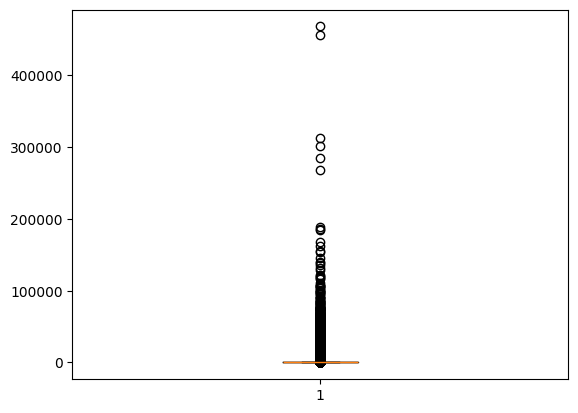

In [13]:
plt.boxplot(ho_df.nb_ho)

In [14]:
PATH_TOPO = '..\\Processed_data\\4G_cells_AGG_week.snappy.parquet'

cells_df = pd.read_parquet(PATH_TOPO, engine='fastparquet')
cells_df = cells_df.loc[cells_df['eci_4g'].isin(ho_df['eci_4g'])].reset_index(drop=True)
cells_df['Score'] = 0 # Nb passages through cell
cells_df

,eci_4g,nom_cellule,couverture,azimuth,longitude,latitude,Score
0,24076298,ROME_ENB1_H3,OUTDOOR,255,2.320547,48.88417,0
1,24076300,ROME_ENB1_V2,OUTDOOR,150,2.320547,48.88417,0
2,24076296,ROME_ENB1_H1,OUTDOOR,30,2.320547,48.88417,0
3,24076299,ROME_ENB1_V1,OUTDOOR,30,2.320547,48.88417,0
4,24076289,ROME_ENB1_E1,OUTDOOR,30,2.320547,48.88417,0
...,...,...,...,...,...,...,...
9567,25935365,RUE_LACROIX_ENB2_F2,OUTDOOR,150,2.322153,48.88992,0
9568,24067588,OSM_JJ_BIRD_INDOOR_ENB1_E2,INDOOR,100,2.258767,48.82576,0
9569,24067587,OSM_JJ_BIRD_INDOOR_ENB1_E1,INDOOR,0,2.258767,48.82576,0
9570,24067585,OSM_JJ_BIRD_INDOOR_ENB1_H1,INDOOR,0,2.258767,48.82576,0


In [16]:
flow_count(ho_df, cells_df)
cells_df

,eci_4g,nom_cellule,couverture,azimuth,longitude,latitude,Score,HO_in,HO_out
0,24076298,ROME_ENB1_H3,OUTDOOR,255,2.320547,48.88417,0,67005,53012
1,24076300,ROME_ENB1_V2,OUTDOOR,150,2.320547,48.88417,0,63289,64380
2,24076296,ROME_ENB1_H1,OUTDOOR,30,2.320547,48.88417,0,56060,23600
3,24076299,ROME_ENB1_V1,OUTDOOR,30,2.320547,48.88417,0,15363,11127
4,24076289,ROME_ENB1_E1,OUTDOOR,30,2.320547,48.88417,0,12453,10017
...,...,...,...,...,...,...,...,...,...
9567,25935365,RUE_LACROIX_ENB2_F2,OUTDOOR,150,2.322153,48.88992,0,1052,3786
9568,24067588,OSM_JJ_BIRD_INDOOR_ENB1_E2,INDOOR,100,2.258767,48.82576,0,61,56
9569,24067587,OSM_JJ_BIRD_INDOOR_ENB1_E1,INDOOR,0,2.258767,48.82576,0,32,26
9570,24067585,OSM_JJ_BIRD_INDOOR_ENB1_H1,INDOOR,0,2.258767,48.82576,0,253,256


Text(0, 0.5, 'HO_out')

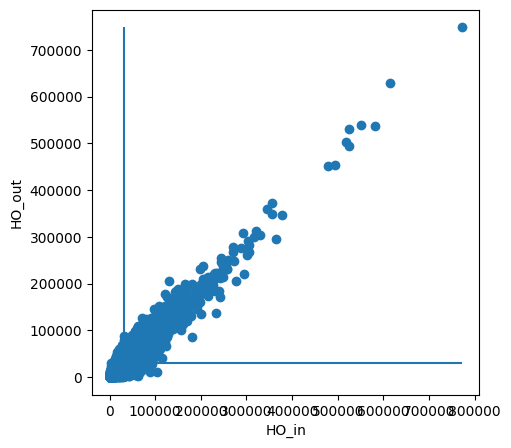

In [17]:
plt.figure(figsize=(5,5))
plt.scatter(cells_df.HO_in, cells_df.HO_out)
plt.vlines(cells_df.HO_in.mean(), 0, cells_df.HO_out.max())
plt.hlines(cells_df.HO_out.mean(), 0, cells_df.HO_in.max())
plt.xlabel('HO_in')
plt.ylabel('HO_out')
#plt.title('')

In [18]:
# Extract points of interest: EnB with traffic above the average 
POI = cells_df.loc[(cells_df.HO_in >= cells_df.HO_in.mean()) & (cells_df.HO_out >= cells_df.HO_out.mean())].eci_4g.tolist()
print('Number of POI:', len(POI))

Number of POI: 2767


In [21]:
hocnam = create_map()
add_stations(hocnam, cells_df.loc[cells_df.eci_4g.isin(POI)], type='enb')
hocnam

Creating base station map...
Adding 4G stations layer


## 2. Loop between all sources and destinations

In [28]:
src = 25298184
dst = 24020233

ENB_SRC = src
ENB_DST = dst
print('Assigning georanks')
cells_df = assign_georank(cells_df, src_id=ENB_SRC)
print('Computing weights')
ho_df = compute_weight(ho_df, METHOD, absolute=ABS, enb_df=cells_df)
G = nx.from_pandas_edgelist(ho_df, source='prev_eci_4g', target='eci_4g', edge_attr='Weight', create_using=nx.DiGraph) # NetworkX graph
print('Computing shortest path')
sp = nx.shortest_path(G, ENB_SRC, ENB_DST, weight='Weight', method='bellman-ford') # Bellman-Ford is better for directed graphs
path = smooth_path(sp, cells_df, INTERP_COEF)
print('Path length:', len(sp), '\tInterpolated path length:', len(path))
cells_df.loc[cells_df.eci_4g.isin(path.eci_4g.tolist()), 'Score'] += 1  # Increment EnB score

print(path)

Assigning georanks
Computing weights
Computing shortest path
Path length: 22 	Interpolated path length: 53
       eci_4g   latitude  longitude
0    25513729  48.859367   2.304850
2    25249793  48.859573   2.307117
4    24043267  48.859779   2.309383
6    25030145  48.859985   2.311650
7    24896519  48.860088   2.312783
10   24210947  48.860397   2.316183
15   25050369  48.863277   2.314350
19   25534481  48.865582   2.312884
20   24636930  48.866158   2.312517
26   25050113  48.863445   2.317282
28   26081295  48.862541   2.318870
31   24909828  48.861276   2.320788
34   24910084  48.860192   2.321777
39   26295298  48.858386   2.323426
42   25456129  48.857473   2.324214
46   25023745  48.856370   2.325129
50   24000261  48.855267   2.326044
54   25291010  48.855375   2.328376
55   25284866  48.855402   2.328959
58   25547034  48.855483   2.330709
66   25235201  48.854219   2.334121
74   24408070  48.852945   2.337237
75   24046347  48.852846   2.337642
76   25119233  48.852747   2.

In [29]:
def add_stations_by_rank(map, df, name='4G stations'):
    print('Adding '+name+' layer...')
    fg = folium.FeatureGroup(name=name) # Name as it will appear in Layer control
    enb_color = {10:'red', 20:'orange', 30:'yellow', 50:'green', 200:'blue'}
    for idx,row in df.iterrows():
        ec = [v for k,v in enb_color.items() if row['Georank'] <= k]
        fg.add_child(folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            popup=row['eci_4g'],
            tooltip='Rank: '+str(row['Georank']),
            color='black',
            weight=1,
            fill=True,
            fill_color=ec[0],
            fill_opacity=0.9,
            radius=10
        ))
    map.add_child(fg)

hocnam = create_map()
folium.TileLayer('CartoDB Positron').add_to(hocnam)
add_stations_by_rank(hocnam, cells_df)
hocnam


Creating base station map...
Adding 4G stations layer...


In [32]:
hocnam = create_map()
folium.TileLayer('CartoDB Positron').add_to(hocnam)
add_voronoi_path(hocnam, cells_df, path, name='Cells path', color='red')
hocnam

Creating base station map...


In [33]:
ho_df

,prev_eci_4g,eci_4g,nb_ho,srcCell,srcLON,srcLAT,dstCell,dstLON,dstLAT,srcRank,dstRank,Weight
index,,,,,,,,,,,,
689,23980801,23983106,5,VILLEDO_ENB1_E1,2.337431,48.867230,BOULE_ROUGE_ENB1_E2,2.344583,48.872950,33.0,41,0.200000
690,23980801,23983107,54,VILLEDO_ENB1_E1,2.337431,48.867230,BOULE_ROUGE_ENB1_E3,2.344583,48.872950,33.0,41,0.018519
691,23980801,23983113,1,VILLEDO_ENB1_E1,2.337431,48.867230,BOULE_ROUGE_ENB1_H3,2.344583,48.872950,33.0,41,1.000000
692,23980801,23983361,3,VILLEDO_ENB1_E1,2.337431,48.867230,TRINITE_BIS_ENB1_E1,2.335047,48.875404,33.0,34,0.333333
693,23980801,23983362,10,VILLEDO_ENB1_E1,2.337431,48.867230,TRINITE_BIS_ENB1_E2,2.335047,48.875404,33.0,34,0.100000
...,...,...,...,...,...,...,...,...,...,...,...,...
3897635,26400778,26152718,8,RUE_BAGNOLET_BIS_ENB2_K2,2.399294,48.856537,CHARONNE_ENB2_K1,2.385781,48.855007,94.0,81,1.750000
3897636,26400778,26172943,1,RUE_BAGNOLET_BIS_ENB2_K2,2.399294,48.856537,PORTE_DE_MONTREUIL_ENB2_K3,2.417500,48.852920,94.0,112,1.000000
3897637,26400778,26246150,3,RUE_BAGNOLET_BIS_ENB2_K2,2.399294,48.856537,MENILMONTANT_ENB2_F2,2.391297,48.866524,94.0,86,3.000000


In [54]:
for i in range(len(POI)):
    ENB_SRC = POI[i]
    with tqdm(total=len(POI), desc='Computing paths from '+ENB_SRC+' ('+str(i)+'/'+str(len(POI))+')') as pbar:
        for j in range(len(POI)):
            ENB_DST = POI[j]
            #print('Computing path between', ENB_SRC, 'and', ENB_DST, '['+str(i)+'/'+str(len(SRC_LIST))+']')
            enb_df_day = assign_georank(enb_df_day, src_id=ENB_SRC)
            ho_df_day = compute_weight(ho_df_day, METHOD, absolute=ABS, enb_df=enb_df_day)
            G = nx.from_pandas_edgelist(ho_df_day, source='srcLocInfo', target='dstLocInfo', edge_attr='Weight', create_using=nx.DiGraph) # NetworkX graph
            sp = nx.shortest_path(G, ENB_SRC, ENB_DST, weight='Weight', method='bellman-ford') # Bellman-Ford is better for directed graphs
            path = smooth_path(sp, enb_df_day, INTERP_COEF)
            #print('Path length:', len(sp), '\tInterpolated path length:', len(path))
            enb_df_day.loc[enb_df_day.LocInfo.isin(path.LocInfo.tolist()), 'Score'] += 1  # Increment EnB score
            pbar.update(1)

Computing paths from 8102f81000009952 (73/74): 100%|██████████| 74/74 [02:23<00:00,  1.94s/it]


(array([92., 25., 14., 19., 21., 12.,  5.,  1.,  6.,  2.]),
 array([   0. ,  155.6,  311.2,  466.8,  622.4,  778. ,  933.6, 1089.2,
        1244.8, 1400.4, 1556. ]),
 <BarContainer object of 10 artists>)

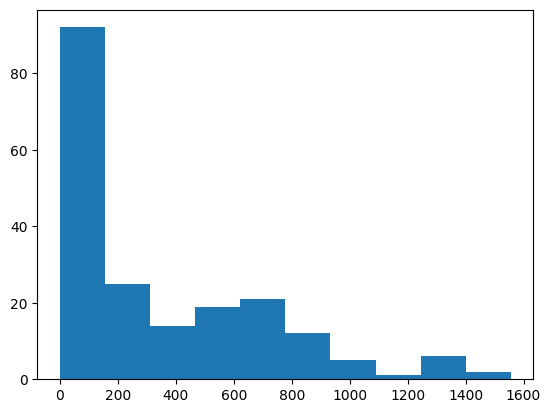

In [55]:
plt.hist(enb_df_day.Score.tolist())

In [56]:
enb_df_day

,LocInfo,TECHNO,LON,LAT,Score,HO_in,HO_out,Georank
0,8102f8100000999d,4G,4.888138,45.738378,0,261866,270897,62
1,8102f81000009b28,4G,4.819723,45.771390,721,184322,184547,20
2,8102f8100000997e,4G,4.875561,45.753615,3,153131,144632,48
3,8102f81000009976,4G,4.846672,45.729169,805,553658,550593,30
4,8102f81000009959,4G,4.822966,45.733027,1281,1324305,1295454,20
...,...,...,...,...,...,...,...,...
192,8102f81000009f4a,4G,4.874679,45.764310,155,1149830,1092377,48
193,8102f8100000997b,4G,4.880686,45.725675,98,130391,132394,59
194,8102f8100000ba70,4G,4.867783,45.701943,2,94091,90597,64
195,8102f8100000996d,4G,4.864943,45.729614,169,465572,478509,44


In [61]:
enb_df_day[['LocInfo', 'LON', 'LAT', 'HO_in', 'HO_out', 'Score']].to_parquet('ENB_SCORE_WEEK.parquet', engine='fastparquet', compression='snappy')

## 3. Folium visualization

In [10]:
import branca
import branca.colormap as cm

In [9]:
enb_df_day = pd.read_parquet('ENB_SCORE_WEEK.parquet', engine='fastparquet')
enb_df_day

,LocInfo,LON,LAT,HO_in,HO_out,Score
0,8102f8100000999d,4.888138,45.738378,261866,270897,0
1,8102f81000009b28,4.819723,45.771390,184322,184547,721
2,8102f8100000997e,4.875561,45.753615,153131,144632,3
3,8102f81000009976,4.846672,45.729169,553658,550593,805
4,8102f81000009959,4.822966,45.733027,1324305,1295454,1281
...,...,...,...,...,...,...
192,8102f81000009f4a,4.874679,45.764310,1149830,1092377,155
193,8102f8100000997b,4.880686,45.725675,130391,132394,98
194,8102f8100000ba70,4.867783,45.701943,94091,90597,2
195,8102f8100000996d,4.864943,45.729614,465572,478509,169


In [11]:
def add_voronoi(map, points, colormap):
    print('Adding Voronoi layer')
    vor = Voronoi(list(zip(points['LAT'].tolist(), points['LON'].tolist())))  # Careful with the inversion!!  
    fg = folium.FeatureGroup(name='Voronoi cells', show=True)
    for enb, reg_idx in enumerate(vor.point_region):
        region = vor.regions[reg_idx]
        cell_locinfo = points.LocInfo.iloc[enb]
        if -1 not in region and region != []:
            region_coords = []
            for vertex in region:
                region_coords.append(vor.vertices[vertex])
            score = points.loc[points.LocInfo==cell_locinfo, 'Score'].iloc[0]
            fg.add_child(folium.Polygon(
                region_coords,
                color="darkgray",
                weight=1,
                fill_color=colormap(score),
                fill_opacity=0.3,
                fill=True,
                tooltip=score
            ))
    map.add_child(fg)
    map.add_child(colormap)

In [12]:
lyon = create_map()
folium.TileLayer('CartoDB Positron').add_to(lyon)
enb_df_day = enb_df_day.fillna(0)
smin, smax = enb_df_day.Score.min(), enb_df_day.Score.max()
colormap = cm.LinearColormap(colors=['lightblue','red'], index=[smin,smax],vmin=smin,vmax=smax)
add_voronoi(lyon, enb_df_day, colormap)

#close_map(lyon, 'lyon_full_daytime_'+METHOD+'_'+str(ABS)+'.html')
lyon

Creating base station map...
Adding Voronoi layer
